<a href="https://colab.research.google.com/github/auliaarmyra/UAS-Deep-Learning_Kelompok-5/blob/main/UAS_Deep_Learning_Kelompok_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


DETEKSI KEBAKARAN HUTAN DARI CITRA SATELIT dengan metode:
Data preprocessing dengan NDVI/thermal bands, Model CNN atau UNet untuk klasifikasi/spasial segmentasi, Visualisasi peta.

=== Tahapan Analisis Data: ====

*   Tahap 1 → Load & EDA
*   Tahap 2 → Hitung NDVI
*   Tahap 3 → Peta Hotspot Awal
*   Tahap 4 → Preprocessing + Normalisasi + Split
*   Tahap 5 → Model CNN sederhana
*   Tahap 6 → Evaluasi IoU & Pixel Accuracy
*   Tahap 7 → Peta Prediksi


In [1]:
# ====== Tahap 1: Load & EDA ======
from google.colab import files
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
print("Upload file Dataset")
uploaded = files.upload()
filename = list(uploaded.keys())[0]
df = pd.read_csv(filename)

Upload file Dataset


Saving DatasetNASA_kebakaran_preprocessed.csv to DatasetNASA_kebakaran_preprocessed.csv


In [7]:
print("Ukuran dataset:", df.shape)
display("\nNama kolom:", df.columns.tolist())

Ukuran dataset: (16591, 22)


'\nNama kolom:'

['latitude',
 'longitude',
 'brightness',
 'scan',
 'track',
 'acq_date',
 'acq_time',
 'satellite',
 'instrument',
 'confidence',
 'version',
 'bright_t31',
 'frp',
 'daynight',
 'type',
 'RED',
 'NIR',
 'SWIR',
 'NDVI',
 'NBR',
 'Thermal_norm',
 'label']

In [8]:
display(df.head())

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,...,frp,daynight,type,RED,NIR,SWIR,NDVI,NBR,Thermal_norm,label
0,1.4905,127.6398,310.8,1.1,1.0,2024-08-15,119,Terra,MODIS,62,...,7.4,D,1,310.8,74.0,16.3,-0.615385,0.638981,0.484346,1
1,0.7899,127.3815,316.8,1.0,1.0,2024-08-15,119,Terra,MODIS,0,...,8.8,D,2,316.8,88.0,16.9,-0.565217,0.677788,0.583794,1
2,1.4919,127.6305,317.3,1.1,1.0,2024-08-15,119,Terra,MODIS,73,...,13.2,D,1,317.3,132.0,21.5,-0.412419,0.719870,0.508287,1
3,-2.5766,121.3840,354.2,1.5,1.2,2024-08-15,120,Terra,MODIS,97,...,117.4,D,2,354.2,1174.0,57.1,0.536448,0.907237,0.532228,0
4,-2.5812,121.3767,329.7,1.5,1.2,2024-08-15,120,Terra,MODIS,84,...,41.8,D,2,329.7,418.0,34.0,0.118095,0.849558,0.506446,1


In [9]:
display(df.describe(include='all').T)

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
latitude,16591.0,NaN,NaN,NaN,-2.991071,3.631585,-10.8364,-6.74665,-2.209,-0.04805,5.5292
longitude,16591.0,NaN,NaN,NaN,115.062817,9.403792,95.4558,109.7737,113.3985,121.3703,141.0647
brightness,16591.0,NaN,NaN,NaN,319.764517,11.699339,300.0,312.9,317.4,323.8,448.9
scan,16591.0,NaN,NaN,NaN,1.387367,0.63078,1.0,1.0,1.1,1.5,4.8
track,16591.0,NaN,NaN,NaN,1.138129,0.201911,1.0,1.0,1.1,1.2,2.0
acq_date,16591,284,2024-09-07,1029,NaN,NaN,NaN,NaN,NaN,NaN,NaN
acq_time,16591.0,NaN,NaN,NaN,675.931529,383.656283,4.0,557.0,637.0,712.0,2351.0
satellite,16591,2,Aqua,12490,NaN,NaN,NaN,NaN,NaN,NaN,NaN
instrument,16591,1,MODIS,16591,NaN,NaN,NaN,NaN,NaN,NaN,NaN
confidence,16591.0,NaN,NaN,NaN,62.271593,21.060669,0.0,50.0,65.0,76.0,100.0


In [10]:
# Missing values
missing = df.isna().mean().sort_values(ascending=False)
print("\nPersentase missing tiap kolom:")
print(missing[missing>0].round(3))


Persentase missing tiap kolom:
Series([], dtype: float64)


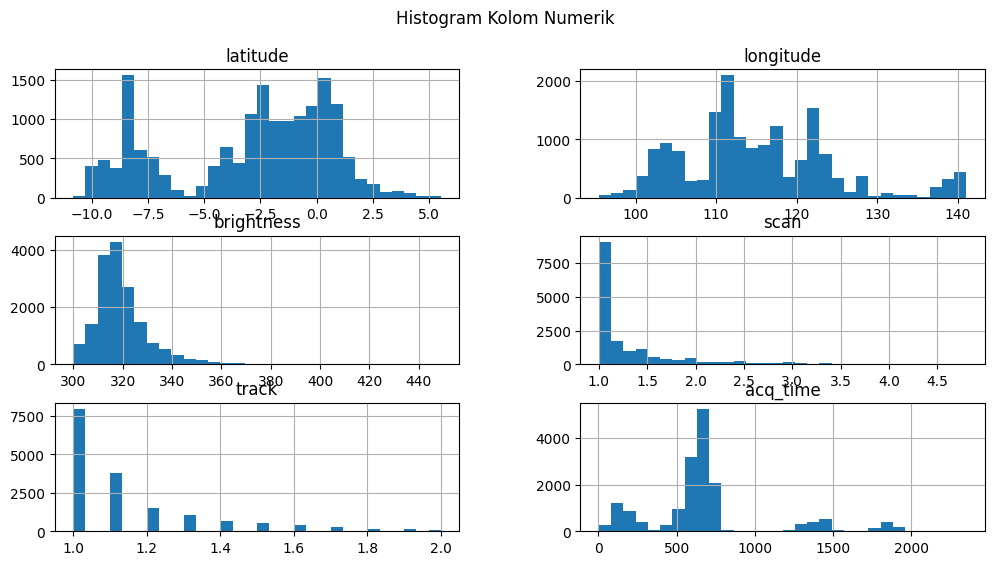

In [11]:
# Visualisasi histogram beberapa kolom numerik
num_cols = df.select_dtypes(include=np.number).columns.tolist()
if num_cols:
    df[num_cols[:6]].hist(figsize=(12,6), bins=30)
    plt.suptitle("Histogram Kolom Numerik")
    plt.show()

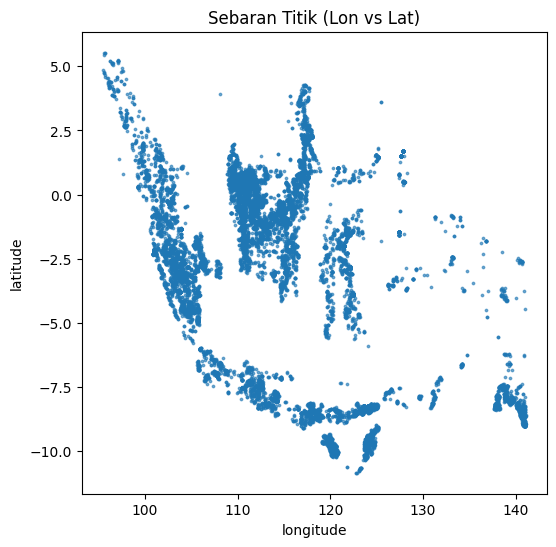

In [12]:
# Peta sebaran lokasi jika ada lat/lon
if any(c.lower().startswith('lat') for c in df.columns) and any(c.lower().startswith('lon') for c in df.columns):
    lat_col = [c for c in df.columns if c.lower().startswith('lat')][0]
    lon_col = [c for c in df.columns if c.lower().startswith('lon')][0]
    plt.figure(figsize=(6,6))
    plt.scatter(df[lon_col], df[lat_col], s=3, alpha=0.6)
    plt.xlabel(lon_col); plt.ylabel(lat_col)
    plt.title("Sebaran Titik (Lon vs Lat)")
    plt.show()

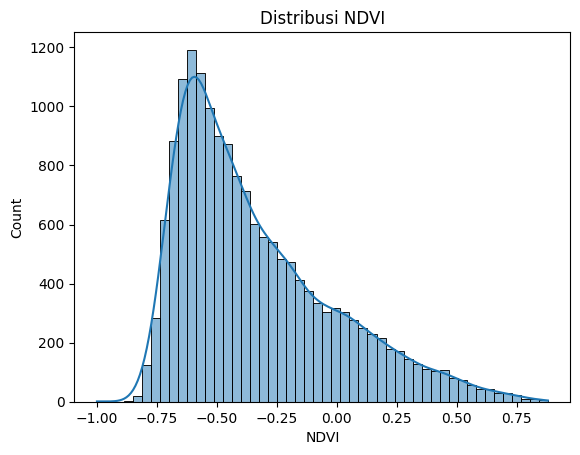

In [13]:
# ====== Tahap 2: Hitung NDVI ======
possible_nir = [c for c in df.columns if 'nir' in c.lower()]
possible_red = [c for c in df.columns if 'red' in c.lower()]
if possible_nir and possible_red:
    nir_col = possible_nir[0]
    red_col = possible_red[0]
    df['NDVI'] = (df[nir_col] - df[red_col]) / (df[nir_col] + df[red_col] + 1e-8)
else:
    num_cols = df.select_dtypes(include=np.number).columns.tolist()
    df['NDVI'] = (df[num_cols[0]] - df[num_cols[1]]) / (df[num_cols[0]] + df[num_cols[1]] + 1e-8)

sns.histplot(df['NDVI'].dropna(), bins=50, kde=True)
plt.title("Distribusi NDVI")
plt.show()

In [30]:
# Visualisasi histogram NIR,RED Dan SWIR
kolom_nir = "NIR"
kolom_red = "RED"
kolom_swir = "SWIR"

# Cek apakah semua kolom ada di df
for col in [kolom_nir, kolom_red, kolom_swir]:
    if col not in df.columns:
        raise ValueError(f"Kolom {col} tidak ditemukan di dataset.")

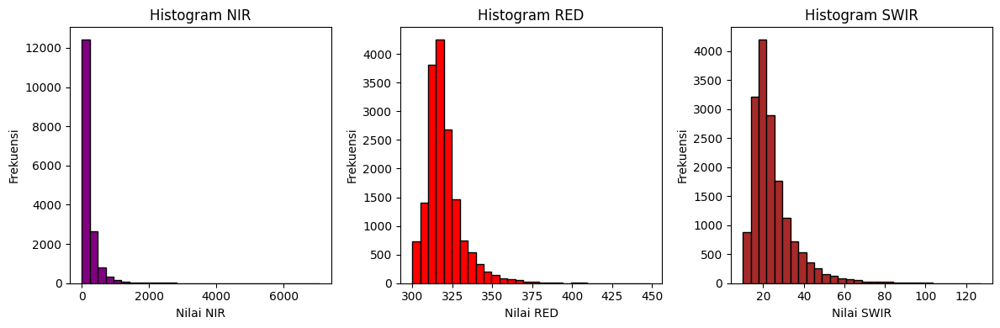

In [31]:
# Plot histogram
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.hist(df[kolom_nir], bins=30, color='purple', edgecolor='black')
plt.title("Histogram NIR")
plt.xlabel("Nilai NIR")
plt.ylabel("Frekuensi")

plt.subplot(1, 3, 2)
plt.hist(df[kolom_red], bins=30, color='red', edgecolor='black')
plt.title("Histogram RED")
plt.xlabel("Nilai RED")
plt.ylabel("Frekuensi")

plt.subplot(1, 3, 3)
plt.hist(df[kolom_swir], bins=30, color='brown', edgecolor='black')
plt.title("Histogram SWIR")
plt.xlabel("Nilai SWIR")
plt.ylabel("Frekuensi")

plt.tight_layout()
plt.show()

In [32]:
# ====== Tahap 3: Peta Hotspot Awal ======
!pip install -q folium
import folium
from folium.plugins import HeatMap

temp_cols = [c for c in df.columns if 'temp' in c.lower()]
lat_cols = [c for c in df.columns if c.lower().startswith('lat')]
lon_cols = [c for c in df.columns if c.lower().startswith('lon')]

if temp_cols:
    temp_col = temp_cols[0]
    thresh = df[temp_col].quantile(0.95)
    df['hotspot_flag'] = (df[temp_col] >= thresh).astype(int)
else:
    ndvi_thresh = df['NDVI'].quantile(0.05)
    df['hotspot_flag'] = (df['NDVI'] <= ndvi_thresh).astype(int)

if lat_cols and lon_cols:
    lat_col = lat_cols[0]; lon_col = lon_cols[0]
    m = folium.Map(location=[df[lat_col].mean(), df[lon_col].mean()], zoom_start=6)
    for _, row in df.iterrows():
        color = 'red' if row['hotspot_flag']==1 else 'blue'
        folium.CircleMarker(location=[row[lat_col], row[lon_col]],
                            radius=2 if row['hotspot_flag']==0 else 4,
                            color=color, fill=True).add_to(m)
    display(m)

Peta yang dihasilkan menunjukkan sebaran titik panas (hotspot) di seluruh Indonesia berdasarkan data yang diproses:
* Titik merah → titik yang diklasifikasikan sebagai hotspot (indikator suhu/indeks vegetasi melewati ambang yang kita tentukan).
* Titik biru → titik pengamatan biasa, bukan hotspot menurut aturan kita.

Dari peta terlihat konsentrasi merah paling banyak di Kalimantan, lalu Nusa Tenggara dan sebagian Sumatra; Papua juga menunjukkan beberapa klaster hotspot.

Secara kasar, Kalimantan menyumbang lebih dari separuh semua titik hotspot yang terdeteksi, sementara Jawa & Bali hampir tidak menunjukkan hotspot berdasarkan aturan ini.

Lokasi-lokasi dengan frekuensi hotspot tertinggi (agregasi sel 0.5°) misalnya di sekitar koordinat ~109–112°E dan beberapa titik di sekitar 104°E — ini mengindikasikan area yang sering muncul laporan panas.

**Kesimpulannya:** peta ini memberi gambaran spasial awal tentang daerah berisiko (rawan kebakaran atau aktivitas termal tinggi). Hasil ini berguna sebagai input awal untuk langkah berikutnya.

In [15]:
# ====== Tahap 4: Preprocessing + Normalisasi + Split ======
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

label_cols = [c for c in df.columns if c.lower() in ('label','fire','hotspot','target')]
if label_cols:
    label_col = label_cols[0]
else:
    df['label'] = df['hotspot_flag']
    label_col = 'label'

exclude = {label_col, 'NDVI', 'hotspot_flag'}
exclude |= set([c for c in df.columns if c.lower().startswith('lat') or c.lower().startswith('lon')])
feature_cols = [c for c in df.columns if c not in exclude and df[c].dtype != 'object']

X = df[feature_cols].fillna(0).values
y = df[label_col].astype(int).values
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_train, X_tmp, y_train, y_tmp = train_test_split(X_scaled, y, test_size=0.30, stratify=y, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_tmp, y_tmp, test_size=0.5, stratify=y_tmp, random_state=42)

In [40]:
# ====== Tahap 5: Model CNN sederhana ======
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks

Xtr = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
Xv = X_val.reshape((X_val.shape[0], X_val.shape[1], 1))
Xt = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

model = models.Sequential([
    layers.Input(shape=Xtr.shape[1:]),
    layers.Conv1D(32, 3, activation='relu', padding='same'),
    layers.MaxPool1D(2),
    layers.Conv1D(64, 3, activation='relu', padding='same'),
    layers.GlobalAveragePooling1D(),
    layers.Dense(64, activation='relu'),
    layers.Dropout(0.4),
    layers.Dense(1, activation='sigmoid')
])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

es = callbacks.EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
history = model.fit(Xtr, y_train, validation_data=(Xv, y_val), epochs=50, batch_size=64, callbacks=[es])


Epoch 1/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.9369 - loss: 0.3095 - val_accuracy: 0.9783 - val_loss: 0.0610
Epoch 2/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9824 - loss: 0.0550 - val_accuracy: 0.9835 - val_loss: 0.0409
Epoch 3/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9842 - loss: 0.0425 - val_accuracy: 0.9859 - val_loss: 0.0364
Epoch 4/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9860 - loss: 0.0370 - val_accuracy: 0.9863 - val_loss: 0.0327
Epoch 5/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9877 - loss: 0.0327 - val_accuracy: 0.9871 - val_loss: 0.0310
Epoch 6/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9892 - loss: 0.0322 - val_accuracy: 0.9908 - val_loss: 0.0295
Epoch 7/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.9890 - loss: 0.0337 - val_accuracy: 0.9912 - val_loss: 0.0270
Epoch 8/50
182/182 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.9920 - loss: 0.0260 - val_accuracy: 0.

In [41]:
# ====== Tahap 6: Evaluasi IoU & Pixel Accuracy ======
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

y_pred_prob = model.predict(Xt).ravel()
y_pred = (y_pred_prob >= 0.5).astype(int)

pix_acc = accuracy_score(y_test, y_pred)
print("Pixel Accuracy:", pix_acc)


78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Pixel Accuracy: 0.9959823222177582


In [43]:
def iou_score(y_true, y_pred):
    y_true = np.array(y_true).astype(bool)
    y_pred = np.array(y_pred).astype(bool)
    intersection = np.logical_and(y_true, y_pred).sum()
    union = np.logical_or(y_true, y_pred).sum()
    return intersection / union if union != 0 else np.nan

print("IoU:", iou_score(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

IoU: 0.9957609156422212
Confusion Matrix:
 [[ 130    7]
 [   3 2349]]
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.95      0.96       137
           1       1.00      1.00      1.00      2352

    accuracy                           1.00      2489
   macro avg       0.99      0.97      0.98      2489
weighted avg       1.00      1.00      1.00      2489



In [44]:
# ====== Tahap 7: Peta Prediksi ======
if lat_cols and lon_cols:
    X_all = df[feature_cols].fillna(0).values
    X_all_scaled = scaler.transform(X_all)
    X_all_in = X_all_scaled.reshape((X_all_scaled.shape[0], X_all_scaled.shape[1], 1))
    pred_prob_all = model.predict(X_all_in).ravel()
    pred_all = (pred_prob_all >= 0.5).astype(int)
    df['pred_prob'] = pred_prob_all
    df['pred'] = pred_all

    m_pred = folium.Map(location=[df[lat_col].mean(), df[lon_col].mean()], zoom_start=6)
    for _, r in df.iterrows():
        color = 'red' if r['pred']==1 else 'green'
        folium.CircleMarker(location=[r[lat_col], r[lon_col]],
                            radius=2 if r['pred']==0 else 4,
                            color=color, fill=True).add_to(m_pred)
    display(m_pred)

    heat_data = [[r[lat_col], r[lon_col], r['pred_prob']] for _, r in df.iterrows()]
    m2 = folium.Map(location=[df[lat_col].mean(), df[lon_col].mean()], zoom_start=6)
    HeatMap(heat_data, radius=10, blur=15, max_zoom=6).add_to(m2)
    display(m2)

519/519 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


Peta yang dihasilkan menunjukkan sebaran titik prediksi hotspot di seluruh Indonesia berdasarkan output model:
*   Titik merah → titik yang diprediksi sebagai hotspot (prediksi = 1) dengan probabilitas tinggi terjadinya aktivitas panas/anomali.
*   Titik hijau → titik yang diprediksi bukan hotspot (prediksi = 0) atau berada pada kondisi normal menurut model.

Dari peta terlihat konsentrasi titik merah paling banyak di Kalimantan, diikuti oleh Nusa Tenggara (NTT/NTB), serta beberapa klaster di wilayah timur Sumatra. Papua juga menampilkan titik-titik yang terisolasi namun tetap masuk kategori prediksi hotspot.

Secara kasar, Kalimantan menyumbang porsi terbesar dari seluruh titik yang diprediksi sebagai hotspot, sedangkan Jawa dan Bali hampir tidak menunjukkan prediksi hotspot pada model ini.

Lokasi dengan intensitas probabilitas prediksi tertinggi (berdasarkan heatmap) terlihat di sekitar koordinat ~109–112°BT serta beberapa titik di kisaran 104°BT, mengindikasikan wilayah dengan risiko berulang atau klaster hotspot yang konsisten muncul.

**Kesimpulannya**: peta ini memberikan gambaran spasial awal daerah yang diprediksi berisiko tinggi, yang dapat menjadi prioritas pemantauan lapangan dan verifikasi data, sehingga lebih efisien dalam menentukan area pengawasan atau tindakan mitigasi.